 # **Task2**

 ### **Stage 0:** _Importing libs. Adding plotter class and sys functions_

In [22]:
import os
# import sys
import time
import pickle
from typing import Tuple, Optional, Any
from functools import wraps
from contextlib import contextmanager
from dataclasses import dataclass
import random

# data
import numpy as np
import pandas as pd
# visualization
import matplotlib.pyplot as plt
import matplotlib.axes as mpl_axes
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
# data workflows
import tqdm
import scipy
from sklearn.decomposition import PCA
from sklearn.datasets import make_blobs
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis
from sklearn.metrics import roc_curve, auc, precision_recall_curve
from sklearn.model_selection import StratifiedKFold


 ##### **_Constants_**

In [23]:
DPI = 150
SAVE_DIR="res"
COLORS = ["#e78284", "#a6d189", "#b4befe"]
MY_COLORS = ["#f38ba8", "#cba6f7"]
MY_CMAP = ListedColormap(MY_COLORS)
MY_SMOOTH_CMAP = LinearSegmentedColormap.from_list(
    "my_smooth_gradient",
    MY_COLORS[::-1],
    N=256
)
EDGECOLOR = "#11111b"
STYLES = ["o", "s", "^"]
# MAKE_16x16 = True
MAKE_16x16 = False


 ##### **_Plotter_**

In [24]:

class Plotter:
    def __init__(self, nrows: int = 1, ncols: int = 1, figsize: Tuple[int, int] = (6, 6)) -> None:
        self.fig, self.axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
        self.nrows = nrows
        self.ncols = ncols
        self.size = self.nrows * self.ncols
        
        if nrows == 1 and ncols == 1:
            self.axes = np.array([self.axes])
        elif nrows == 1 or ncols == 1:
            self.axes = self.axes.reshape(-1)
        else:
            self.axes = self.axes.flatten()

        self.position = None
    
    def __getitem__(self, index: int):
        return self._get_axes_by_index(index)
    
    def __getattr__(self, name: str):
        if hasattr(mpl_axes.Axes, name):
            def dynamic_method(*args, 
                             idx: Optional[int] = None,
                             irow: Optional[int] = None,
                             icol: Optional[int] = None,
                             **kwargs):
                ax = self._get_axis(idx, irow, icol) if self.position is None else self.position
                method = getattr(ax, name)
                return method(*args, **kwargs)
            
            return dynamic_method
        
        raise AttributeError(f"\"{type(self).__name__}\" object has no attribute \"{name}\"")
    
    def _get_axes_by_index(self, idx: int = 0) -> Any:
        return self.axes[idx]
    
    def _get_axes_by_coords(self, irow: int = 0, icol: int = 0) -> Any:
        idx = irow * self.ncols + icol
        return self.axes[idx]

    def _get_axis(self,
                  idx: Optional[int] = None,
                  irow: Optional[int] = None,
                  icol: Optional[int] = None) -> Any:
        if idx is not None:
            return self._get_axes_by_index(idx)
        elif irow is not None and icol is not None:
            return self._get_axes_by_coords(irow, icol)
        else:
            raise ValueError("ERROR: Wrong indexation!")
    
    def set_position(self,
                     idx: Optional[int] = None,
                     irow: Optional[int] = None,
                     icol: Optional[int] = None) -> None:
        
        self.position = self._get_axis(idx, irow, icol)
    
    def del_position(self) -> None:
        self.position = None
    
    def dataset_visual(self, X, y, colors, styles, edgecolor, alpha=0.6) -> None:
        if self.size != len(X.columns) ** 2:
            raise ValueError("ERROR: Features count not matched with figure size!")
        
        columns = X.columns
        classes = y.unique()
        for i, rowname in enumerate(columns):
            for j, colname in enumerate(columns):
                self.set_position(irow=i, icol=j)
                
                for k, class_value in enumerate(classes):
                    class_mask = y == class_value
                    if i == j:
                        local_data = X[class_mask][colname]
                        kde = scipy.stats.gaussian_kde(local_data)
                        x = np.linspace(local_data.min(), local_data.max(), 100)
                        self.fill_between(x, np.zeros_like(x), kde(x), color=colors[k], alpha=alpha, label=f"class \"{class_value}\"")
                        continue

                    self.scatter(X[class_mask][colname], X[class_mask][rowname], marker=styles[k], color=colors[k], edgecolor=edgecolor, alpha=alpha, label=f"class \"{class_value}\"")
                
                if i == j:
                    self.labels("value", "count", colname)
                else:
                    self.labels(colname, rowname, "")
                
                self.grid(True, alpha=0.3)
                self.legend()
        
    def labels(self,
               xlabel: str,
               ylabel: str,
               title: str,
               idx: Optional[int] = None,
               irow: Optional[int] = None,
               icol: Optional[int] = None) -> Any:

        ax = self._get_axis(idx, irow, icol) if self.position is None else self.position
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        ax.set_title(title)
        return ax

    def tight_layout(self) -> None:
        self.fig.tight_layout()
    
    def save(self, path: str, dpi: int = 300, **kwargs) -> None:
        self.fig.savefig(path, dpi=dpi, **kwargs)
    
    def show(self) -> None:
        self.fig.show()


 ##### **_Sys functions_**

In [25]:
def data_stats(data1, data2) -> Any:
    Pearson_v, Pearson_pv = scipy.stats.pearsonr(data1, data2)
    spearman_v, spearman_pv = scipy.stats.spearmanr(data1, data2)

    return np.array([Pearson_v, Pearson_pv, spearman_v, spearman_pv])


def get_cov_matrixes(df, features, classes):
    stats = np.zeros((len(features), len(features), (len(classes) + 1) * 4))

    for i, iparam in enumerate(features):
        for j, jparam in enumerate(features):
            data = np.array(df[[iparam, jparam, "target"]])
            
            stats[i, j, 0:4] = data_stats(data[..., 0], data[..., 1])

            for k, group in enumerate(classes):
                data_by_class = data[data[..., -1] == k]
                
                stats[i, j, (k + 1) * 4:(k + 2) * 4] = data_stats(data_by_class[..., 0], data_by_class[..., 1])
    
    return stats


In [26]:

def cache_data(cache_file):
    def decorator(func):
        @wraps(func)
        def wrapper(*args, **kwargs):
            if os.path.exists(cache_file):
                print(f"\033[90m> Loading from cache: {cache_file}\033[0m")
                with open(cache_file, "rb") as f:
                    return pickle.load(f)
            else:
                print("\033[90m> Generating a new object...\033[0m")
                obj = func(*args, **kwargs)
                with open(cache_file, "wb") as f:
                    pickle.dump(obj, f)
                print(f"\033[90m> Object loaded to cache: {cache_file}\033[0m")
                return obj
        return wrapper
    return decorator


@dataclass
class TimerResult:
    elapsed: float
    start: float
    end: float


@contextmanager
def timer():
    start = time.perf_counter()
    result = TimerResult(elapsed=0, start=start, end=0)
    
    yield result 
    
    result.end = time.perf_counter()
    result.elapsed = result.end - result.start


def select_unique(arr, n):
    unique_sorted = np.unique(arr)
    
    if len(unique_sorted) <= n:
        return unique_sorted
    
    indices = np.linspace(0, len(unique_sorted)-1, n, dtype=int)
    return indices


 ### **Stage 1** (tasks [1] [2] [3]): _Creating base dataset and dublicates_

 ##### **_Function and parameters_**

In [27]:

np.random.seed(42)
n_samples = 1000
n_features = 16
n_classes = 3

COLUMNS = [f"feature_{i+1}" for i in range(n_features)]


@cache_data("cache/df1_main.pkl")
def create_dataframe(n_samples, n_features, n_classes):
    X1, y1 = make_blobs(n_samples=n_samples, 
                        n_features=n_features, 
                        centers=1,
                        cluster_std=2.5,
                        center_box=(-7, -8),
                        random_state=42)
    X2, y2 = make_blobs(n_samples=n_samples, 
                        n_features=n_features, 
                        centers=1,
                        cluster_std=2.5,
                        center_box=(-5, -5),
                        random_state=42)
    X3, y3 = make_blobs(n_samples=n_samples, 
                        n_features=n_features, 
                        centers=1,
                        cluster_std=1.6,
                        center_box=(5.0, 5.0),
                        random_state=42)

    X = np.vstack([X1, X2, X3])
    y = np.hstack([y1, np.full(y2.shape, 1), np.full(y3.shape, 2)])

    df = pd.DataFrame(X, columns=COLUMNS)
    df["target"] = y

    return df


 ##### **_Creating dataframe_**

In [28]:

df1 = create_dataframe(n_samples, n_features, n_classes)

print(f"Размерность df1: {df1.shape}")
print(f"Количество классов: {len(df1["target"].unique())}")
print("Количество объектов в каждом классе:")
print(df1["target"].value_counts().sort_index())
print(df1.describe())



> Loading from cache: cache/df1_main.pkl
Размерность df1: (3000, 17)
Количество классов: 3
Количество объектов в каждом классе:
target
0    1000
1    1000
2    1000
Name: count, dtype: int64
          feature_1     feature_2     feature_3     feature_4     feature_5  \
count  3.000000e+03  3.000000e+03  3.000000e+03  3.000000e+03  3.000000e+03   
mean  -2.404888e+00 -2.734410e+00 -2.585909e+00 -2.499537e+00 -2.389579e+00   
std    5.807781e+00  5.964232e+00  5.931694e+00  5.876902e+00  5.766260e+00   
min   -1.581349e+01 -1.695343e+01 -1.585783e+01 -1.568007e+01 -1.458928e+01   
25%   -7.027302e+00 -7.475092e+00 -7.309815e+00 -7.152570e+00 -6.981915e+00   
50%   -4.232736e+00 -4.632192e+00 -4.358865e+00 -4.316317e+00 -4.224465e+00   
75%    3.943164e+00  3.845576e+00  3.900941e+00  3.936255e+00  3.885684e+00   
max    9.377536e+00  9.162693e+00  1.004329e+01  1.128198e+01  1.002468e+01   

          feature_6     feature_7     feature_8     feature_9    feature_10  \
count  3.000000e+0

 ##### **_Cov matrixes_**

> Loading from cache: cache/cov_matrixes.pkl


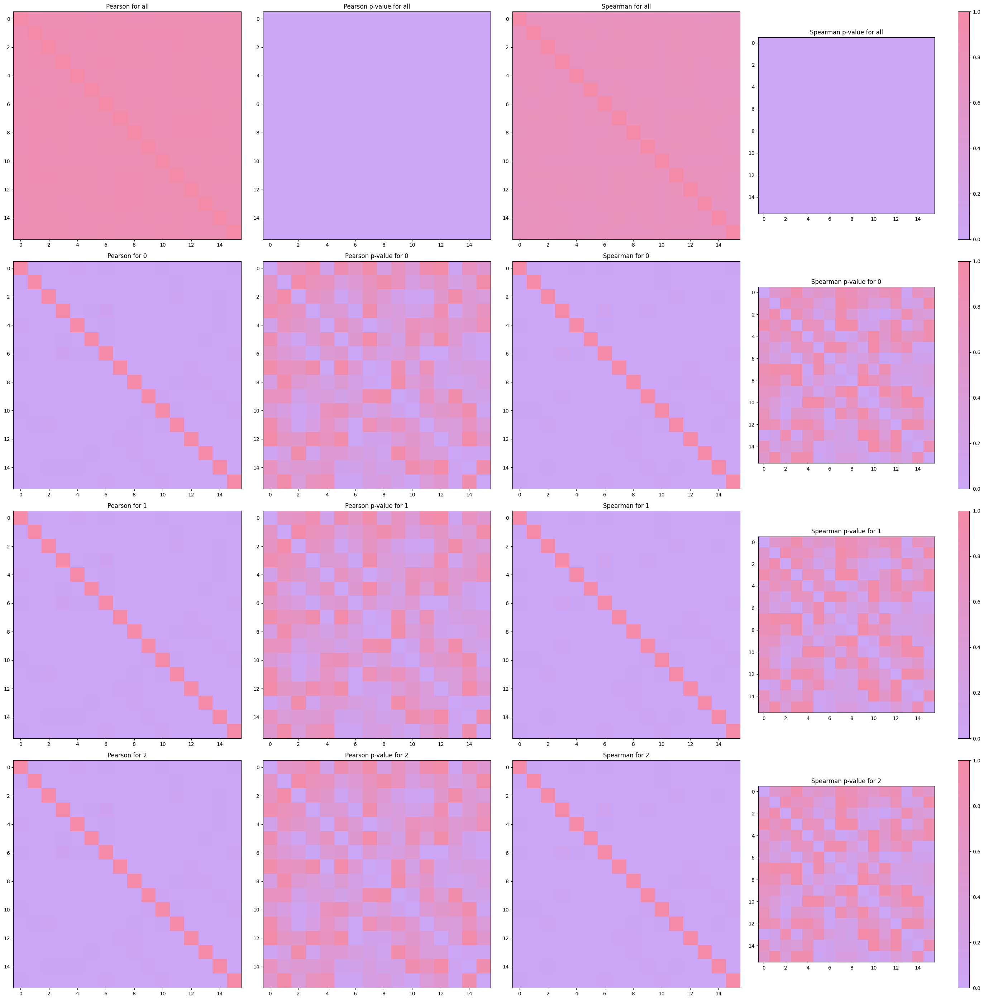

In [29]:
@cache_data("cache/cov_matrixes.pkl")
def get_cov(df):
    cov_matrixes = get_cov_matrixes(df, COLUMNS, [0, 1, 2])
    
    return cov_matrixes


cov_matrixes = get_cov(df1)

plotter = Plotter(nrows=4, ncols=4, figsize=(28, 28))

class_names = ["all", "0", "1", "2"]
for i in range(4):
    plotter.set_position(idx=i * 4)
    plotter.imshow(cov_matrixes[..., i * 4], cmap=MY_SMOOTH_CMAP, vmin=0.0, vmax=1.0)
    plotter.labels("", "", f"Pearson for {class_names[i]}")
    
    plotter.set_position(idx=i * 4 + 1)
    plotter.imshow(cov_matrixes[..., i * 4 + 1], cmap=MY_SMOOTH_CMAP, vmin=0.0, vmax=1.0)
    plotter.labels("", "", f"Pearson p-value for {class_names[i]}")

    plotter.set_position(idx=i * 4 + 2)
    plotter.imshow(cov_matrixes[..., i * 4 + 2], cmap=MY_SMOOTH_CMAP, vmin=0.0, vmax=1.0)
    plotter.labels("", "", f"Spearman for {class_names[i]}")
    
    plotter.set_position(idx=i * 4 + 3)
    im = plotter.imshow(cov_matrixes[..., i * 4 + 3], cmap=MY_SMOOTH_CMAP, vmin=0.0, vmax=1.0)
    plotter.labels("", "", f"Spearman p-value for {class_names[i]}")

    cbar = plotter.fig.colorbar(im, ax=plotter.position,
                       orientation='vertical',
                       pad=0.1)

plotter.tight_layout()
plotter.save("res/corelations.png")


In [30]:

all_data = []
groups = []
classes = [0, 1, 2]

for k in range(len(classes) + 1):
    group = classes[k - 1] if k > 0 else "all"
    groups.append(group)
    data = {
        "Pair": [],
        "Pearson": [],
        "Pearson p-value": [],
        "Spearman": [],
        "Spearman p-value": []
    }
    local_matrix = cov_matrixes[..., (k * 4):(k + 1) * 4]
    elems = ["Pearson", "Pearson p-value", "Spearman", "Spearman p-value"]
    for i, iparam in enumerate(COLUMNS):
        for j, jparam in enumerate(COLUMNS):
                data["Pair"].append(f"{iparam} x {jparam}")
                data["Pearson"].append(local_matrix[i, j, 0])
                data["Pearson p-value"].append(local_matrix[i, j, 1])
                data["Spearman"].append(local_matrix[i, j, 2])
                data["Spearman p-value"].append(local_matrix[i, j, 3])
    data = pd.DataFrame(data)
    data.to_csv(f"res/stats_for_{group}.csv", index=False)
    
    all_data.append(data)


In [31]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)
pd.set_option('display.float_format', lambda x: f'{x:.6e}')

print(f"Stats for {groups[0]}")
all_data[0]


Stats for all


,Pair,Pearson,Pearson p-value,Spearman,Spearman p-value
0,feature_1 x feature_1,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00
1,feature_1 x feature_2,8.608011e-01,0.000000e+00,7.385838e-01,0.000000e+00
2,feature_1 x feature_3,8.485206e-01,0.000000e+00,7.227210e-01,0.000000e+00
3,feature_1 x feature_4,8.501072e-01,0.000000e+00,7.250444e-01,0.000000e+00
4,feature_1 x feature_5,8.532372e-01,0.000000e+00,7.239855e-01,0.000000e+00
5,feature_1 x feature_6,8.463516e-01,0.000000e+00,7.112975e-01,0.000000e+00
6,feature_1 x feature_7,8.535286e-01,0.000000e+00,7.216359e-01,0.000000e+00
7,feature_1 x feature_8,8.566886e-01,0.000000e+00,7.334652e-01,0.000000e+00
8,feature_1 x feature_9,8.454145e-01,0.000000e+00,7.224666e-01,0.000000e+00
9,feature_1 x feature_10,8.476206e-01,0.000000e+00,7.227570e-01,0.000000e+00


In [32]:
print(f"Stats for {groups[1]}")
all_data[1]


Stats for 0


,Pair,Pearson,Pearson p-value,Spearman,Spearman p-value
0,feature_1 x feature_1,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00
1,feature_1 x feature_2,1.669338e-02,5.980079e-01,2.080519e-02,5.110741e-01
2,feature_1 x feature_3,-1.354763e-02,6.687258e-01,-1.668334e-02,5.982280e-01
3,feature_1 x feature_4,-4.850244e-03,8.782506e-01,3.866452e-03,9.028076e-01
4,feature_1 x feature_5,4.292894e-02,1.749529e-01,2.528523e-02,4.244547e-01
5,feature_1 x feature_6,-5.070902e-03,8.727578e-01,-1.811716e-02,5.671557e-01
6,feature_1 x feature_7,1.584790e-02,6.166814e-01,2.224907e-02,4.821902e-01
7,feature_1 x feature_8,2.098206e-03,9.471643e-01,5.905518e-03,8.520394e-01
8,feature_1 x feature_9,-3.505453e-02,2.680884e-01,-8.334728e-03,7.923639e-01
9,feature_1 x feature_10,-1.273045e-02,6.876215e-01,-1.431133e-02,6.512537e-01


In [33]:
print(f"Stats for {groups[2]}")
all_data[2]


Stats for 1


,Pair,Pearson,Pearson p-value,Spearman,Spearman p-value
0,feature_1 x feature_1,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00
1,feature_1 x feature_2,1.669338e-02,5.980079e-01,2.080519e-02,5.110741e-01
2,feature_1 x feature_3,-1.354763e-02,6.687258e-01,-1.668334e-02,5.982280e-01
3,feature_1 x feature_4,-4.850244e-03,8.782506e-01,3.866452e-03,9.028076e-01
4,feature_1 x feature_5,4.292894e-02,1.749529e-01,2.528523e-02,4.244547e-01
5,feature_1 x feature_6,-5.070902e-03,8.727578e-01,-1.811716e-02,5.671557e-01
6,feature_1 x feature_7,1.584790e-02,6.166814e-01,2.224907e-02,4.821902e-01
7,feature_1 x feature_8,2.098206e-03,9.471643e-01,5.905518e-03,8.520394e-01
8,feature_1 x feature_9,-3.505453e-02,2.680884e-01,-8.334728e-03,7.923639e-01
9,feature_1 x feature_10,-1.273045e-02,6.876215e-01,-1.431133e-02,6.512537e-01


In [34]:
print(f"Stats for {groups[3]}")
all_data[3]


Stats for 2


,Pair,Pearson,Pearson p-value,Spearman,Spearman p-value
0,feature_1 x feature_1,1.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00
1,feature_1 x feature_2,1.669338e-02,5.980079e-01,2.080519e-02,5.110741e-01
2,feature_1 x feature_3,-1.354763e-02,6.687258e-01,-1.668334e-02,5.982280e-01
3,feature_1 x feature_4,-4.850244e-03,8.782506e-01,3.866452e-03,9.028076e-01
4,feature_1 x feature_5,4.292894e-02,1.749529e-01,2.528523e-02,4.244547e-01
5,feature_1 x feature_6,-5.070902e-03,8.727578e-01,-1.811716e-02,5.671557e-01
6,feature_1 x feature_7,1.584790e-02,6.166814e-01,2.224907e-02,4.821902e-01
7,feature_1 x feature_8,2.098206e-03,9.471643e-01,5.905518e-03,8.520394e-01
8,feature_1 x feature_9,-3.505453e-02,2.680884e-01,-8.334728e-03,7.923639e-01
9,feature_1 x feature_10,-1.273045e-02,6.876215e-01,-1.431133e-02,6.512537e-01


 ##### **_PCA for dataset_**

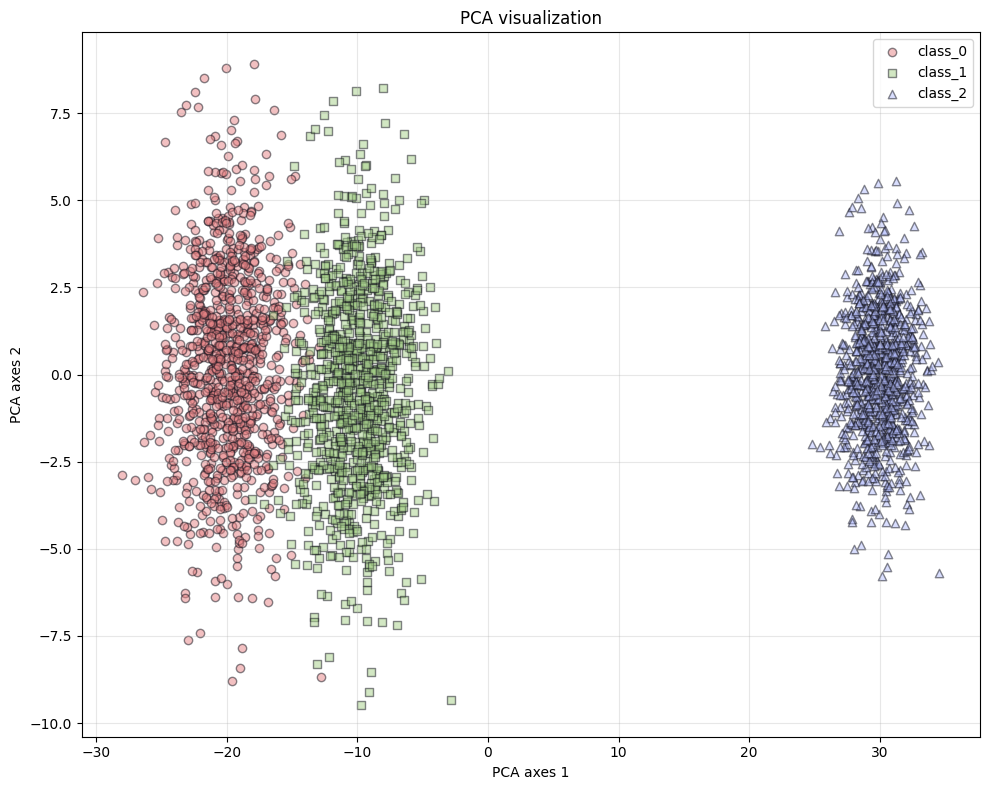

In [35]:
X = df1[COLUMNS]
y = df1["target"]

plotter = Plotter(nrows=1, ncols=1, figsize=(10, 8))
plotter.set_position(idx=0)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

for class_value in range(n_classes):
    mask = y == class_value
    plotter.scatter(X_pca[mask, 0], X_pca[mask, 1], alpha=0.5, marker=STYLES[class_value], color=COLORS[class_value], edgecolor=EDGECOLOR, label=f"class_{class_value}")

plotter.labels("PCA axes 1", "PCA axes 2", "PCA visualization")
plotter.grid(True, alpha=0.3)
plotter.legend()
plotter.tight_layout()
plotter.save(f"{SAVE_DIR}/data_PCA.png", dpi=DPI)


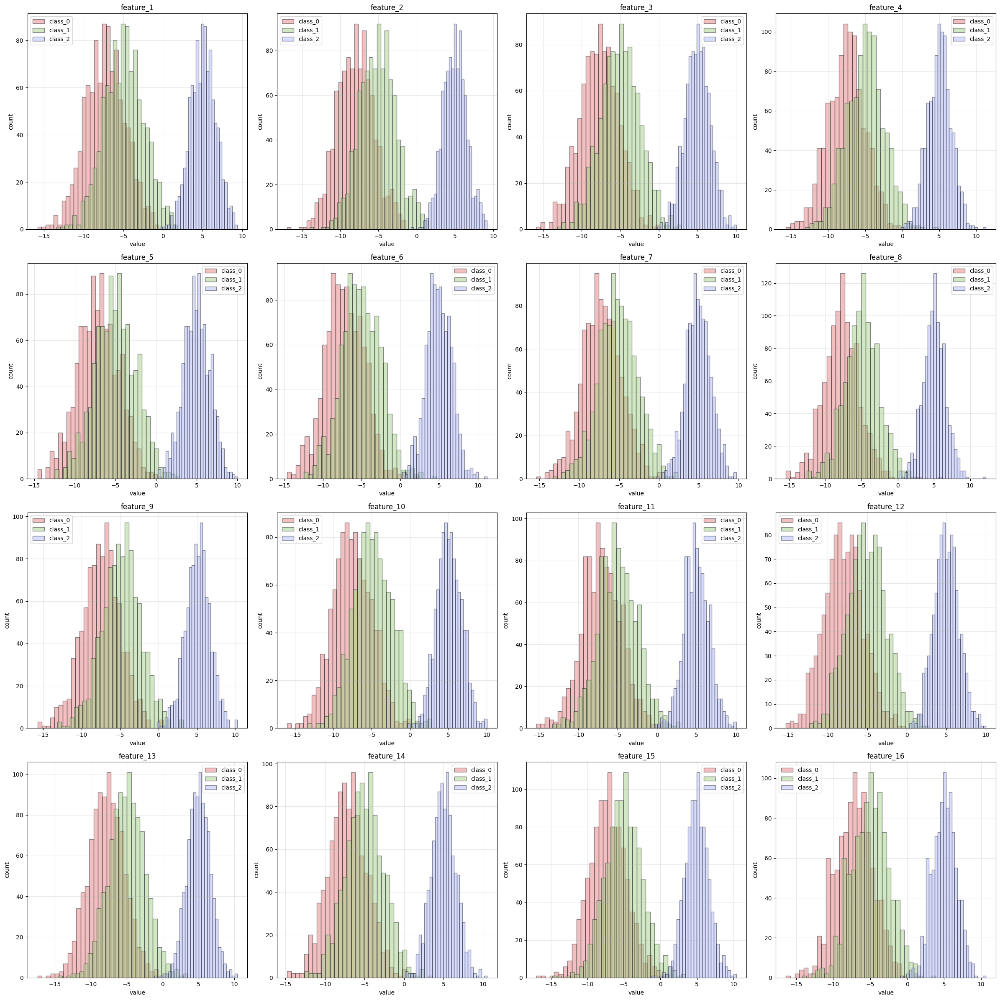

In [36]:
plotter = Plotter(nrows=4, ncols=4, figsize=(24, 24))

for i, col in enumerate(COLUMNS):
    plotter.set_position(idx=i)

    for class_value in range(n_classes):
        mask = y == class_value
        plotter.hist(df1[mask][col], bins=30, color=COLORS[class_value], alpha=0.5, edgecolor=EDGECOLOR, label=f"class_{class_value}")
    plotter.labels("value", "count", col)
    plotter.grid(True, alpha=0.3)
    plotter.legend()

plotter.tight_layout()
plotter.save(f"{SAVE_DIR}/df1_hists.png", dpi=DPI)


 ##### **_Creating datasets with copies_**

In [37]:
CLASS_TO_REPEAT = 1
repetition_factors = [2, 5, 10, 20, 50, 100, 1000, 10000]

datasets = {"df1": df1}

for factor in repetition_factors:
    df_name = f"df{factor}"
    
    @cache_data(f"cache/{df_name}.pkl")
    def generate_copy(base_df):
        new_df = base_df.copy()
        class_samples = df1[df1["target"] == CLASS_TO_REPEAT]
        repeated_samples = pd.concat([class_samples] * (factor - 1), ignore_index=True)
        new_df = pd.concat([new_df, repeated_samples], ignore_index=True)
        
        return new_df
    
    new_df = generate_copy(df1)
    datasets[df_name] = new_df
    print(f"Getted {df_name}: {new_df.shape} objects")

DATASET_NAMES = list(datasets.keys())


> Loading from cache: cache/df2.pkl
Getted df2: (4000, 17) objects
> Loading from cache: cache/df5.pkl
Getted df5: (7000, 17) objects
> Loading from cache: cache/df10.pkl
Getted df10: (12000, 17) objects
> Loading from cache: cache/df20.pkl
Getted df20: (22000, 17) objects
> Loading from cache: cache/df50.pkl
Getted df50: (52000, 17) objects
> Loading from cache: cache/df100.pkl
Getted df100: (102000, 17) objects
> Loading from cache: cache/df1000.pkl
Getted df1000: (1002000, 17) objects
> Loading from cache: cache/df10000.pkl
Getted df10000: (10002000, 17) objects


 ##### **_All dataset visualization_**

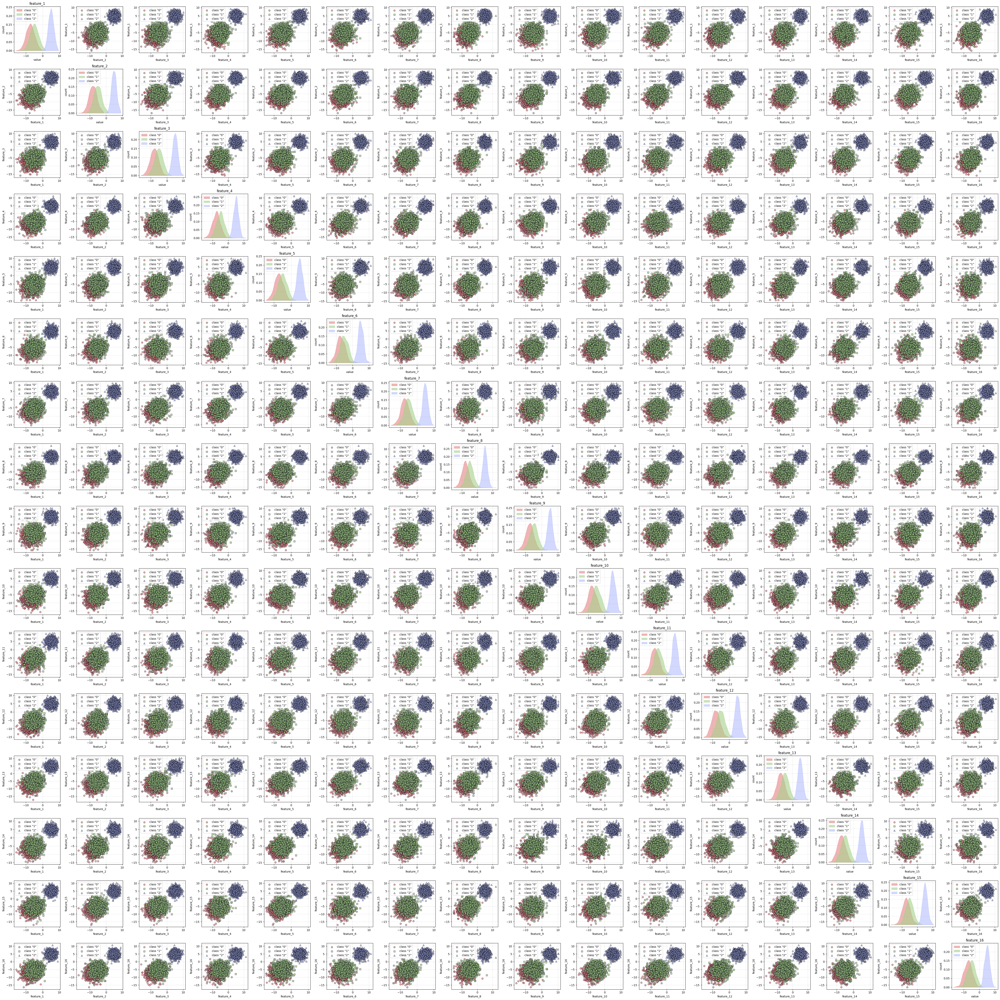

In [39]:
plotter = Plotter(nrows=16, ncols=16, figsize=(50, 50))
plotter.dataset_visual(df1[COLUMNS], df1["target"], COLORS, STYLES, EDGECOLOR, alpha=0.6)
    
plotter.tight_layout()
plotter.save("res/df1_16x16.png", dpi=200)


 ### **Stage 2** (tasks [4] [5] [6] [7] [9]): _LDA with ROC and PR for different situations_

 ##### **_Basic functions for further tasks_**

In [ ]:

def fit_model(name, model, X, y):
    with timer() as t:
        @cache_data(name)
        def func(X, y):
            l_model = model
            l_model.fit(X, y)
            
            return l_model
        
        fitted_model = func(X, y)

    return fitted_model, t.elapsed


def filter_data(df, classes, features):
    df_filtered = df[df["target"].isin(classes)].copy()
    df_filtered["target"] = pd.factorize(df_filtered["target"])[0]
    X, y = df_filtered[features].values, df_filtered["target"].values
    
    return df_filtered, X, y


def calc_mass_points(df, name, features):
    centers = {}
    classes = df["target"].unique()
    for class_label in classes:
        class_data = df[df["target"] == class_label][features]
        center = class_data.mean().values
        centers[class_label] = center
    
    overall_center = df[features].mean().values
    
    midpoint = (centers[classes[0]] + centers[classes[1]]) / 2
    
    return {
        "dataset": name,
        "center_class_0": centers[classes[0]],
        "center_class_1": centers[classes[1]],
        "overall_center": overall_center,
        "midpoint": midpoint
    }


def ROC_PR_calc(model, X, y, roc=True, pr=True, no_proj=False):
    prediction = model.predict_proba(X)[:, 1]
    if no_proj:
        projections = prediction
    else:
        projections = model.transform(X).ravel()
    size = len(projections)

    res = {"prediction": prediction,
           "projections": projections,
           "size": size}

    if roc:
        fpr, tpr, _ = roc_curve(y, prediction)
        aucroc = auc(fpr, tpr)
        
        res["fpr"] = fpr
        res["tpr"] = tpr
        res["aucroc"] = aucroc
    if pr:
        precision, recall, _ = precision_recall_curve(y, prediction)
        precision_orig_interp = np.interp(recall, recall[::-1], precision[::-1], left=1.0, right=0.0)
        auprc = auc(recall, precision)
        
        res["recall"] = recall
        res["precision"] = precision_orig_interp
        res["auprc"] = auprc
    
    return res


def ROC_PR_calc_with_area(model, X, y, roc=True, pr=True, n_bootstraps=1000, confidence_level=0.95, no_proj=False):
    data = ROC_PR_calc(model, X, y, roc, pr, no_proj=no_proj)

    roc_scores = []
    pr_scores = []
    tpr_matrix = []
    precision_matrix = []

    for _ in tqdm.tqdm(range(n_bootstraps), desc=f"ROC and PR {confidence_level * 100}% CI calculating", unit="Bootstrap"):
        idx = np.random.choice(data["size"], data["size"], replace=True)
        if roc:
            fpr_boot, tpr_boot, _ = roc_curve(y[idx], data["projections"][idx])
            roc_scores.append(auc(fpr_boot, tpr_boot))
            tpr_interp = np.interp(data["fpr"], fpr_boot, tpr_boot, left=0, right=1)
            tpr_matrix.append(tpr_interp)
        if pr:
            precision_boot, recall_boot, _ = precision_recall_curve(y[idx], data["projections"][idx])
            pr_scores.append(auc(recall_boot, precision_boot))
            precision_interp = np.interp(data["recall"], recall_boot[::-1], precision_boot[::-1], left=1, right=0)
            precision_matrix.append(precision_interp)
    
    if roc:
        tpr_matrix = np.array(tpr_matrix)
    if pr:
        precision_matrix = np.array(precision_matrix)
    
    alpha = 1 - confidence_level
    lower_percentile = (alpha / 2) * 100
    upper_percentile = (1 - alpha / 2) * 100
    
    res = data
    
    if roc:
        tpr_lower = np.percentile(tpr_matrix, lower_percentile, axis=0)
        tpr_upper = np.percentile(tpr_matrix, upper_percentile, axis=0)
        tpr_mean = np.mean(tpr_matrix, axis=0) 
        tpr_area = np.trapezoid(tpr_upper - tpr_lower, data["fpr"])
        
        res["roc_score_mean"] = np.mean(roc_scores)
        res["tpr_lower"] = tpr_lower
        res["tpr_upper"] = tpr_upper
        res["tpr_mean"] = tpr_mean
        res["tpr_area"] = tpr_area

    if pr:
        precision_lower = np.percentile(precision_matrix, lower_percentile, axis=0)
        precision_upper = np.percentile(precision_matrix, upper_percentile, axis=0)
        precision_mean = np.mean(precision_matrix, axis=0) 
        precision_area = np.trapezoid(precision_upper - precision_lower, data["recall"])
        
        res["pr_score_mean"] = np.mean(pr_scores)
        res["precision_lower"] = precision_lower
        res["precision_upper"] = precision_upper
        res["precision_mean"] = precision_mean
        res["precision_area"] = precision_area
    
    return res


def draw_curve(plotter, idx, ox, oy_origin, oy_mean, oy_lower, oy_upper, score, score_mean, area, conf_level, name, labels, line=([0, 1], [0, 1])):
    plotter.set_position(idx=idx)

    plotter.plot(*line, color="red", alpha=0.5, linestyle="--")
    plotter.fill_between(ox, oy_lower, oy_upper, color="green", alpha=0.3, label=f"{name} CI for {conf_level * 100}% ({area:.6f})")
    plotter.plot(ox, oy_mean, color="blue", linewidth=2, label=f"{name}-curve mean ({score_mean:.6f})")
    plotter.plot(ox, oy_origin, color="red", linewidth=1, label=f"{name}-curve origin ({score:.6f})")
    plotter.grid(True, alpha=0.3)
    plotter.legend()
    plotter.labels(*labels)


def draw_model(plotter, idx, size, model, X, y, centers_info, labels, scatter_max=1000):
    plotter.set_position(idx=idx)

    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, size),
                         np.linspace(y_min, y_max, size))
    
    Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    plotter.contourf(xx, yy, Z, alpha=0.3, cmap=MY_CMAP)
    selected_indexes = select_unique(X[:, 0], scatter_max)
    plotter.scatter(X[:, 0][selected_indexes], X[:, 1][selected_indexes], c=y[selected_indexes], 
                    cmap=MY_CMAP, edgecolors=EDGECOLOR, s=30)

    plotter.plot([centers_info["center_class_0"][0], centers_info["center_class_1"][0]],
                 [centers_info["center_class_0"][1], centers_info["center_class_1"][1]], "k--", linewidth=3)
    plotter.scatter(centers_info["center_class_0"][0], centers_info["center_class_0"][1], 
                   c="red", marker="X", s=250, label="Center Class 0", alpha=0.8, edgecolors=EDGECOLOR)
    plotter.scatter(centers_info["center_class_1"][0], centers_info["center_class_1"][1], 
                   c="blue", marker="X", s=250, label="Center Class 1", alpha=0.8, edgecolors=EDGECOLOR)
    plotter.scatter(centers_info["overall_center"][0], centers_info["overall_center"][1], 
                   c="green", marker="*", s=300, label="Overall Center", alpha=0.8, edgecolors=EDGECOLOR)
    plotter.scatter(centers_info["midpoint"][0], centers_info["midpoint"][1], 
                   c="purple", marker="D", s=150, label="Midpoint", alpha=0.8, edgecolors=EDGECOLOR)

    plotter.labels(*labels)
    plotter.legend()



 ##### **_Main train and stats calculating function_**

In [ ]:

def make_stats_for_model(plotter, model, name, datasets, features, classes, n_bootstraps=(1000, 10), confidence_level=0.95, no_proj=False):
    @cache_data("cache/centers_data.pkl")
    def get_centers_data():
        centers_data = []
        return centers_data

    centers_data = get_centers_data()
    lda_times = {}
    for i, dataset in enumerate(DATASET_NAMES):
        if dataset not in datasets:
            continue
        
        df = datasets[dataset]
        
        df_filtered, X_plot, y_plot = filter_data(df, classes, features)

        if not bool(centers_data):
            centers_data.append(calc_mass_points(df_filtered, dataset, features))
        
        model, time_elapsed = fit_model(f"cache/{name}_{classes[0]}_{classes[1]}_{features[0]}_{features[1]}_{dataset}.pkl",
                                        model, X_plot, y_plot)

        lda_times[dataset] = time_elapsed
        
        @cache_data(f"cache/{name}_roc_pr_{classes[0]}_{classes[1]}_{features[0]}_{features[1]}_{dataset}.pkl")
        def get_roc_pr():
            return ROC_PR_calc_with_area(model, X_plot, y_plot, n_bootstraps=(n_bootstraps[0] if len(y_plot) < 1000000 else n_bootstraps[1]), no_proj=no_proj)
        
        roc_pr_stat = get_roc_pr()

        plotter.set_position(idx=i * 3 + 1)
        
        draw_curve(plotter, i * 3 + 1,
                   roc_pr_stat["fpr"], roc_pr_stat["tpr"], roc_pr_stat["tpr_mean"],
                   roc_pr_stat["tpr_lower"], roc_pr_stat["tpr_upper"],
                   roc_pr_stat["aucroc"], roc_pr_stat["roc_score_mean"],
                   roc_pr_stat["tpr_area"],
                   confidence_level, "ROC", ("FPR", "TPR", f"ROC-curve for {dataset}"))

        draw_curve(plotter, i * 3 + 2,
                   roc_pr_stat["recall"], roc_pr_stat["precision"], roc_pr_stat["precision_mean"],
                   roc_pr_stat["precision_lower"], roc_pr_stat["precision_upper"],
                   roc_pr_stat["auprc"], roc_pr_stat["pr_score_mean"],
                   roc_pr_stat["precision_area"],
                   confidence_level, "PR", ("recall", "precision", f"PR-curve for {dataset}"), line=([0, 1], [1, 0]))
        plotter.invert_xaxis()

        draw_model(plotter, i * 3, 500, model, X_plot, y_plot, centers_data[-1], (features[0], features[1], dataset))

    centers_df = pd.DataFrame(centers_data)
    print("Mass centers:")
    print(centers_df)
    
    return lda_times


 ##### **_LDA 1_**

> Loading from cache: cache/centers_data.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df1.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:01<00:00, 664.12Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df1.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df2.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:01<00:00, 596.75Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df2.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df5.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:02<00:00, 454.69Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df5.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df10.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:03<00:00, 322.57Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df10.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df20.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:04<00:00, 208.57Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df20.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df50.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:09<00:00, 100.93Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df50.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df100.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:18<00:00, 53.19Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df100.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df1000.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 10/10 [00:02<00:00,  4.38Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df1000.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_0_1_feature_7_feature_9_df10000.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 10/10 [00:34<00:00,  3.46s/Bootstrap]


> Object loaded to cache: cache/lda_roc_pr_0_1_feature_7_feature_9_df10000.pkl
Mass centers:
  dataset                           center_class_0  \
0     df1  [-7.194950361900323, -7.45328551312756]   

                             center_class_1  \
0  [-5.136866749732124, -4.852170501384351]   

                             overall_center  \
0  [-6.165908555816224, -6.152728007255956]   

                                   midpoint  
0  [-6.165908555816223, -6.152728007255956]  
Time elapsed for df1: 0.0042004879999240075
Time elapsed for df2: 0.0022860620000528797
Time elapsed for df5: 0.0026276869999719565
Time elapsed for df10: 0.008664011999940158
Time elapsed for df20: 0.005821269000080065
Time elapsed for df50: 0.012017244000048777
Time elapsed for df100: 0.019268036999960714
Time elapsed for df1000: 0.15730882399998336
Time elapsed for df10000: 3.7223103669999773


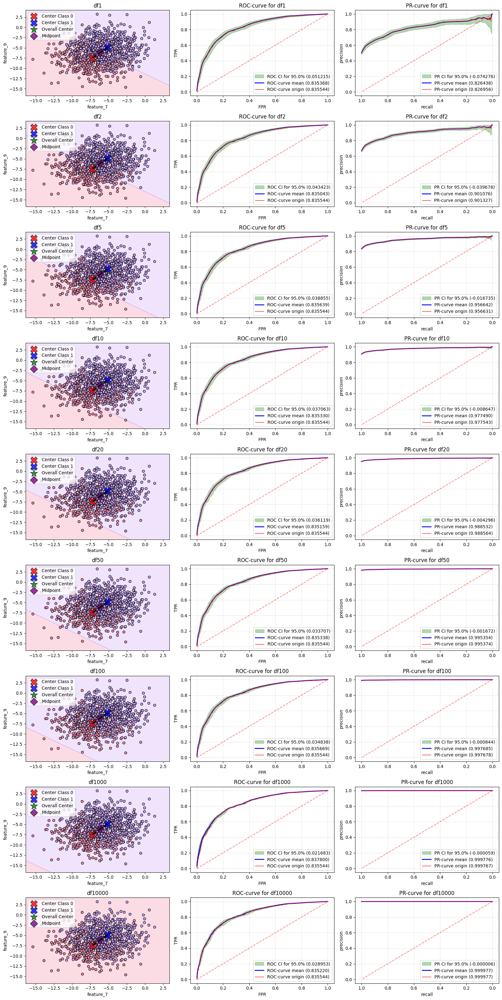

In [40]:
selected_classes = [0, 1]
# selected_features = [COLUMNS[0], COLUMNS[3]]
selected_features = [COLUMNS[6], COLUMNS[8]]
# selected_features = [COLUMNS[5], COLUMNS[15]]

plotter = Plotter(nrows=len(datasets), ncols=3, figsize=(16, 32))

times = make_stats_for_model(plotter, LinearDiscriminantAnalysis(), "lda", datasets, selected_features, selected_classes)

for (key, time_elapsed) in times.items():
    print(f"Time elapsed for {key}: {time_elapsed}")

plotter.tight_layout()
plotter.save("res/LDA_ROC_PR_1.png", dpi=DPI)


 ##### **_LDA 2_**

> Loading from cache: cache/centers_data.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df1.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:01<00:00, 676.01Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df1.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df2.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:01<00:00, 629.60Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df2.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df5.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:02<00:00, 463.17Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df5.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df10.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:03<00:00, 324.52Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df10.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df20.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:04<00:00, 208.24Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df20.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df50.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:09<00:00, 100.78Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df50.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df100.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:18<00:00, 53.66Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df100.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df1000.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 10/10 [00:02<00:00,  4.40Bootstrap/s]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df1000.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_1_2_feature_7_feature_9_df10000.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 10/10 [00:33<00:00,  3.30s/Bootstrap]


> Object loaded to cache: cache/lda_roc_pr_1_2_feature_7_feature_9_df10000.pkl
Mass centers:
  dataset                            center_class_0  \
0     df1  [-5.136866749732124, -4.852170501384351]   

                          center_class_1  \
0  [4.91240528017144, 5.094610879114015]   

                                overall_center  \
0  [-0.11223073478034166, 0.12122018886483192]   

                                      midpoint  
0  [-0.11223073478034173, 0.12122018886483188]  
Time elapsed for df1: 0.0020383699999229066
Time elapsed for df2: 0.004190160999996806
Time elapsed for df5: 0.0025565260000348644
Time elapsed for df10: 0.003760229000022264
Time elapsed for df20: 0.005623970999977246
Time elapsed for df50: 0.011522906999971383
Time elapsed for df100: 0.02199984100002439
Time elapsed for df1000: 0.18739069200000813
Time elapsed for df10000: 2.2493654879999667


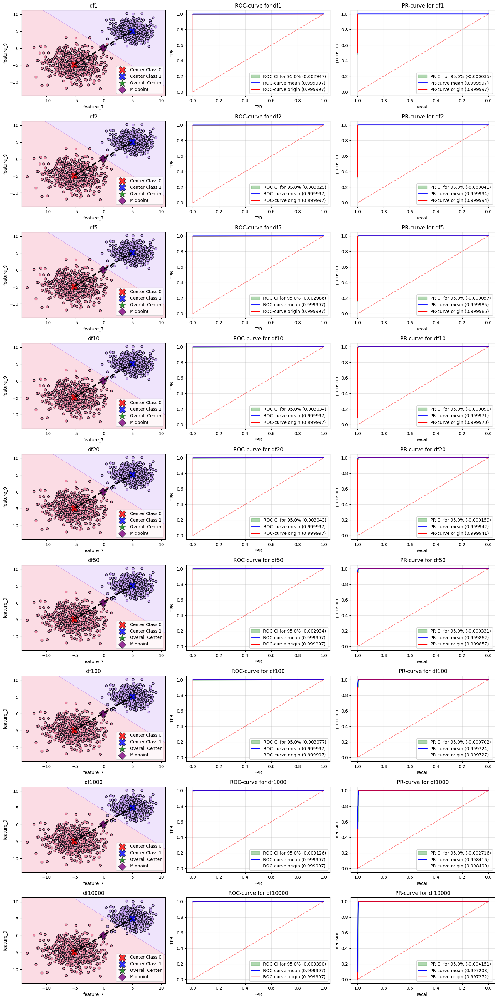

In [41]:

selected_classes = [1, 2]
# selected_features = [COLUMNS[0], COLUMNS[3]]
selected_features = [COLUMNS[6], COLUMNS[8]]
# selected_features = [COLUMNS[5], COLUMNS[15]]

plotter = Plotter(nrows=len(datasets), ncols=3, figsize=(16, 32))

times = make_stats_for_model(plotter, LinearDiscriminantAnalysis(), "lda", datasets, selected_features, selected_classes)

for (key, time_elapsed) in times.items():
    print(f"Time elapsed for {key}: {time_elapsed}")

plotter.tight_layout()
plotter.save("res/LDA_ROC_PR_2.png", dpi=DPI)


 ##### **_LDA for all features_**

> Generating a new object...
> Object loaded to cache: cache/lda_many_0_1_2.pkl
Time elapsed for 2: 0.0017253720000098838
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:01<00:00, 617.13Bootstrap/s]


> Object loaded to cache: cache/lda_many_roc_pr_0_1.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_many_0_1_4.pkl
Time elapsed for 4: 0.001494827999977133
> Loading from cache: cache/lda_many_roc_pr_0_1.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_many_0_1_8.pkl
Time elapsed for 8: 0.002140047000011691
> Loading from cache: cache/lda_many_roc_pr_0_1.pkl
> Generating a new object...
> Object loaded to cache: cache/lda_many_0_1_16.pkl
Time elapsed for 16: 0.005843075000029785
> Loading from cache: cache/lda_many_roc_pr_0_1.pkl


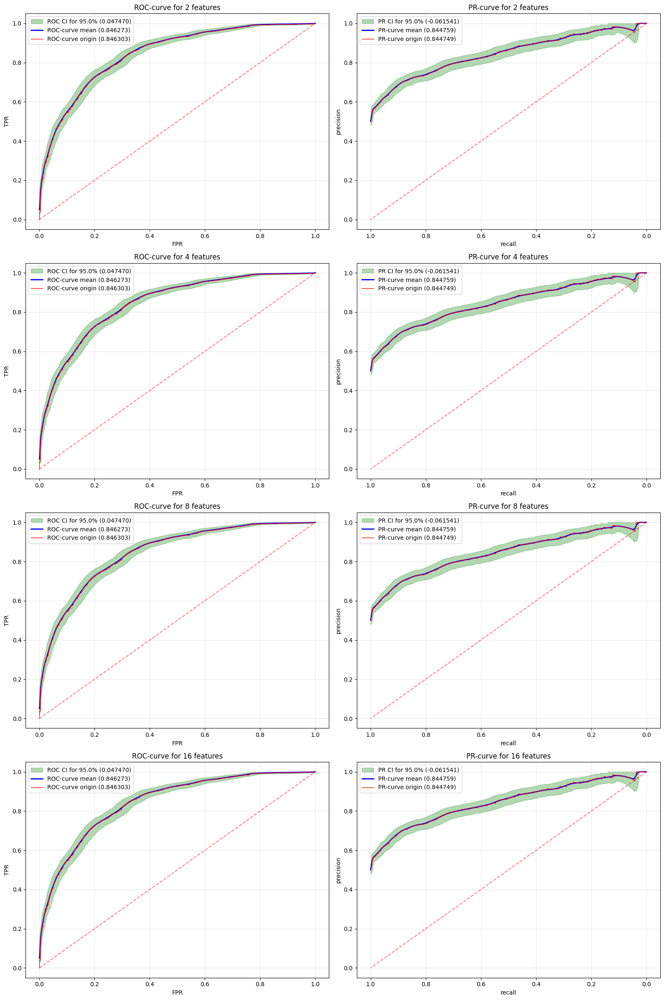

In [42]:

confidence_level = 0.95
n_bootstraps = (1000, 10)
selected_classes = [0, 1]

plotter = Plotter(nrows=4, ncols=2, figsize=(16, 24))

df = datasets["df1"]
    
for i, current_n_features in enumerate([2, 4, 8, 16]):
    selected_features = random.sample(COLUMNS, current_n_features)
    
    df_filtered, X_plot, y_plot = filter_data(df, selected_classes, selected_features)
    
    model, time_elapsed = fit_model(f"cache/lda_many_{selected_classes[0]}_{selected_classes[1]}_{current_n_features}.pkl",
                                    LinearDiscriminantAnalysis(), X_plot, y_plot)
    
    print(f"Time elapsed for {current_n_features}:", time_elapsed)

    @cache_data(f"cache/lda_many_roc_pr_{classes[0]}_{classes[1]}.pkl")
    def get_roc_pr():
        return ROC_PR_calc_with_area(model, X_plot, y_plot, n_bootstraps=(n_bootstraps[0] if len(y_plot) < 1000000 else n_bootstraps[1]))
    
    roc_pr_stat = get_roc_pr()

    draw_curve(plotter, i * 2,
               roc_pr_stat["fpr"], roc_pr_stat["tpr"], roc_pr_stat["tpr_mean"],
               roc_pr_stat["tpr_lower"], roc_pr_stat["tpr_upper"],
               roc_pr_stat["aucroc"], roc_pr_stat["roc_score_mean"],
               roc_pr_stat["tpr_area"],
               confidence_level, "ROC", ("FPR", "TPR", f"ROC-curve for {current_n_features} features"))

    draw_curve(plotter, i * 2 + 1,
               roc_pr_stat["recall"], roc_pr_stat["precision"], roc_pr_stat["precision_mean"],
               roc_pr_stat["precision_lower"], roc_pr_stat["precision_upper"],
               roc_pr_stat["auprc"], roc_pr_stat["pr_score_mean"],
               roc_pr_stat["precision_area"],
               confidence_level, "PR", ("recall", "precision", f"PR-curve for {current_n_features} features"), line=([0, 1], [1, 0]))
    plotter.invert_xaxis()

plotter.tight_layout()
plotter.save("res/ROC_PR_many_features.png", dpi=DPI)


 ### **Stage 3** (task [8]): _LDA k-folds validation_

100%|██████████| 100/100 [00:00<00:00, 292.80it/s]


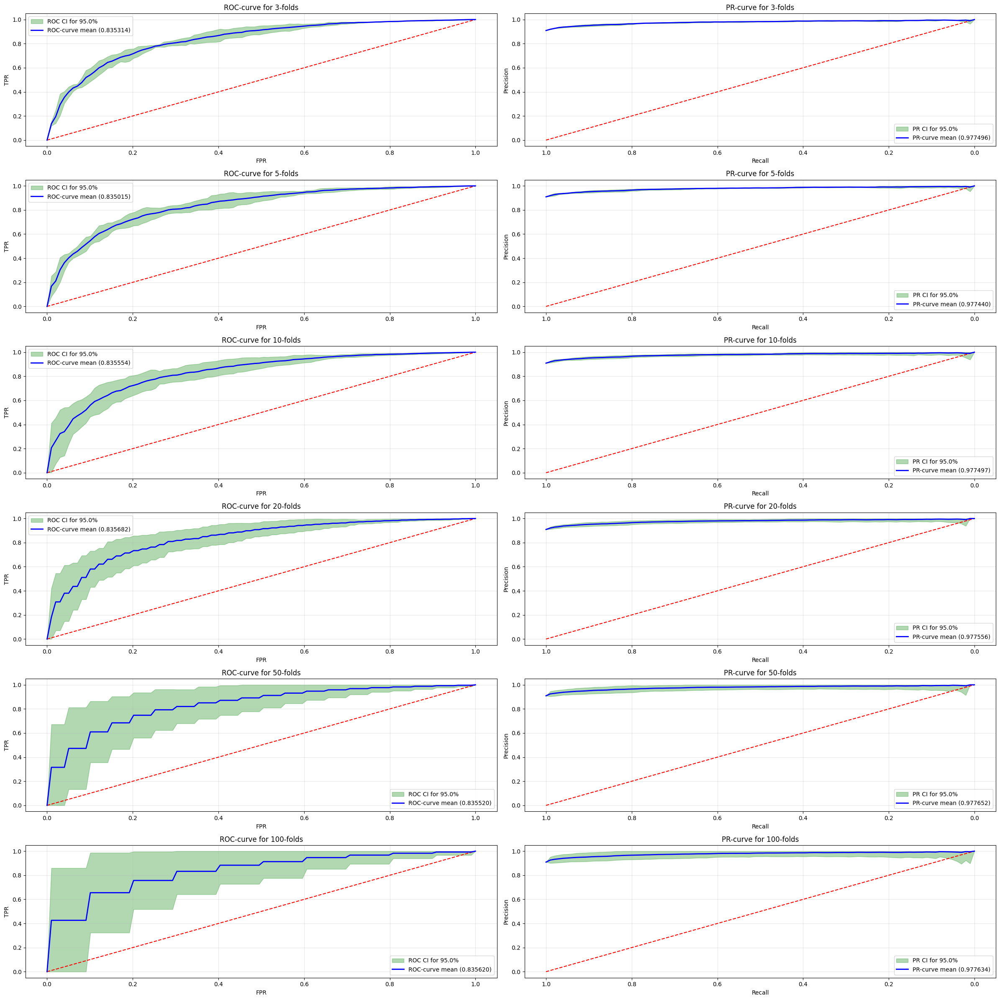

In [43]:

confidence_level = 0.95
selected_classes = [0, 1]
df = datasets["df10"]
# selected_features = COLUMNS
# selected_features = [COLUMNS[5], COLUMNS[15]]
selected_features = [COLUMNS[6], COLUMNS[8]]
df_filtered, X, y = filter_data(df, selected_classes, selected_features)
model = LinearDiscriminantAnalysis()

plotter = Plotter(nrows=6, ncols=2, figsize=(24, 24))

k_folds = [3, 5, 10, 20, 50, 100]
for i, k in enumerate(k_folds):
    kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    
    all_fpr = []
    all_tpr = []
    all_precision = []
    all_recall = []
    all_auc_roc = []
    all_auc_prc = []
    
    mean_fpr = np.linspace(0, 1, 100)
    mean_recall = np.linspace(0, 1, 100)

    for train_idx, test_idx in tqdm.tqdm(kf.split(X, y), total=k):
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]
        
        model.fit(X_train, y_train)
        
        y_proba = model.predict_proba(X_test)[:, 1]
        
        fpr, tpr, _ = roc_curve(y_test, y_proba)
        roc_auc = auc(fpr, tpr)
        
        interp_tpr = np.interp(mean_fpr, fpr, tpr)
        interp_tpr[0] = 0.0
        all_fpr.append(mean_fpr)
        all_tpr.append(interp_tpr)
        all_auc_roc.append(roc_auc)
        
        precision, recall, _ = precision_recall_curve(y_test, y_proba)
        prc_auc = auc(recall, precision)
        
        interp_precision = np.interp(mean_recall, recall[::-1], precision[::-1])
        all_precision.append(interp_precision)
        all_recall.append(mean_recall)
        all_auc_prc.append(prc_auc)
    
    all_tpr = np.array(all_tpr)
    all_precision = np.array(all_precision)
    
    mean_tpr = np.mean(all_tpr, axis=0)
    std_tpr = np.std(all_tpr, axis=0)
    
    mean_precision = np.mean(all_precision, axis=0)
    std_precision = np.std(all_precision, axis=0)
    
    tpr_upper = np.minimum(mean_tpr + scipy.stats.norm.ppf((1 + confidence_level) / 2) * std_tpr, 1)
    tpr_lower = np.maximum(mean_tpr - scipy.stats.norm.ppf((1 + confidence_level) / 2) * std_tpr, 0)
    
    precision_upper = np.minimum(mean_precision + scipy.stats.norm.ppf((1 + confidence_level) / 2) * std_precision, 1)
    precision_lower = np.maximum(mean_precision - scipy.stats.norm.ppf((1 + confidence_level) / 2) * std_precision, 0)
    
    plotter.set_position(idx=i * 2)

    plotter.plot([0, 1], [0, 1], color="red", linestyle="--")
    plotter.fill_between(mean_fpr, tpr_lower, tpr_upper, color="green", alpha=0.3, label=f"ROC CI for {confidence_level * 100}%")
    plotter.plot(mean_fpr, mean_tpr, color="blue", linewidth=2, label=f"ROC-curve mean ({np.mean(all_auc_roc):.6f})")
    plotter.grid(True, alpha=0.3)
    plotter.legend()
    plotter.labels("FPR", "TPR", f"ROC-curve for {k}-folds")
    
    plotter.set_position(idx=i * 2 + 1)
    
    plotter.plot([1, 0], [0, 1], color="red", linestyle="--")
    plotter.fill_between(mean_recall, precision_lower, precision_upper, color="green", alpha=0.3, label=f"PR CI for {confidence_level * 100}%")
    plotter.plot(mean_recall, mean_precision, color="blue", linewidth=2, label=f"PR-curve mean ({np.mean(all_auc_prc):.6f})")
    plotter.grid(True, alpha=0.3)
    plotter.legend()
    plotter.labels("Recall", "Precision", f"PR-curve for {k}-folds")

    plotter.invert_xaxis()

plotter.tight_layout()
plotter.save("res/k-fold_ROC_PR.png", dpi=DPI)


 ### **Stage 4** (task [10]): _QDA_

> Loading from cache: cache/centers_data.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df1.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:01<00:00, 697.88Bootstrap/s]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df1.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df2.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:01<00:00, 586.90Bootstrap/s]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df2.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df5.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:02<00:00, 457.69Bootstrap/s]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df5.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df10.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:03<00:00, 327.20Bootstrap/s]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df10.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df20.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:04<00:00, 208.43Bootstrap/s]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df20.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df50.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:09<00:00, 101.29Bootstrap/s]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df50.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df100.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 1000/1000 [00:18<00:00, 53.23Bootstrap/s]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df100.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df1000.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 10/10 [00:02<00:00,  4.37Bootstrap/s]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df1000.pkl
> Generating a new object...
> Object loaded to cache: cache/qda_0_1_feature_7_feature_9_df10000.pkl
> Generating a new object...


ROC and PR 95.0% CI calculating: 100%|██████████| 10/10 [00:35<00:00,  3.51s/Bootstrap]


> Object loaded to cache: cache/qda_roc_pr_0_1_feature_7_feature_9_df10000.pkl
Mass centers:
  dataset                           center_class_0  \
0     df1  [-7.194950361900323, -7.45328551312756]   

                             center_class_1  \
0  [-5.136866749732124, -4.852170501384351]   

                             overall_center  \
0  [-6.165908555816224, -6.152728007255956]   

                                   midpoint  
0  [-6.165908555816223, -6.152728007255956]  
Time elapsed for df1: 0.004977219000011246
Time elapsed for df2: 0.0010144769998987613
Time elapsed for df5: 0.0017550610000398592
Time elapsed for df10: 0.0020404110000527
Time elapsed for df20: 0.00364007500002117
Time elapsed for df50: 0.005334084999958577
Time elapsed for df100: 0.009915521000039007
Time elapsed for df1000: 0.07548534499983361
Time elapsed for df10000: 0.9334400770001139


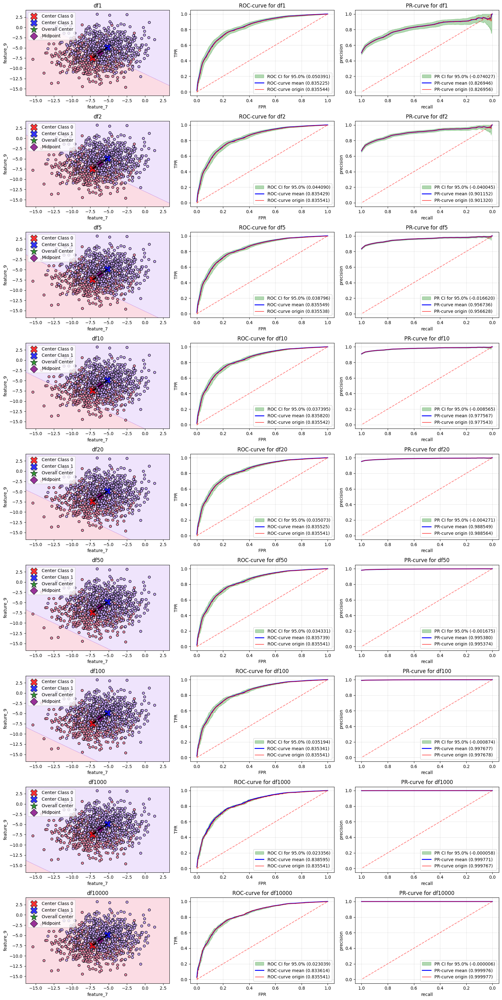

In [44]:
selected_classes = [0, 1]
# selected_features = [COLUMNS[0], COLUMNS[3]]
selected_features = [COLUMNS[6], COLUMNS[8]]
# selected_features = [COLUMNS[5], COLUMNS[15]]

plotter = Plotter(nrows=len(datasets), ncols=3, figsize=(16, 32))

times = make_stats_for_model(plotter, QuadraticDiscriminantAnalysis(), "qda", datasets, selected_features, selected_classes, no_proj=True)

for (key, time_elapsed) in times.items():
    print(f"Time elapsed for {key}: {time_elapsed}")

plotter.tight_layout()
plotter.save("res/QDA_ROC_PR.png", dpi=DPI)
